In [1]:
from pathlib import Path
import os

from astropy.nddata import CCDData
from astropy.visualization import hist
from astropy.stats import mad_std

import ccdproc as ccdp
import matplotlib.pyplot as plt
import numpy as np
import sys
from astropy import units as u


sys.path.append("/home/idies/workspace/Storage/madisonleblanc/persistent/hrpo-pipeline")
import fpnfix
from aperturePhot import showimage as show_image

from astropy.io import fits
from astropy.wcs import WCS
from astropy.coordinates import SkyCoord
import aperturePhot as ap

In [2]:
path = "/home/idies/workspace/Storage/madisonleblanc/persistent/reductions_ASTR4261/"
day = "20211129"
path_day = os.path.join(path, day)

data_red = Path(path_day, "Reduced_Images")
data_red.mkdir(exist_ok = True)

In [3]:
files = ccdp.ImageFileCollection(path_day)
files.summary['file', 'imagetyp', 'filter', 'exptime', 'naxis1', 'naxis2']

file,imagetyp,filter,exptime,naxis1,naxis2
str15,str11,object,float64,int64,int64
Bias-001.fit,Bias Frame,--,0.0,1024,1024
Bias-002.fit,Bias Frame,--,0.0,1024,1024
Bias-003.fit,Bias Frame,--,0.0,1024,1024
Bias-004.fit,Bias Frame,--,0.0,1024,1024
Bias-005.fit,Bias Frame,--,0.0,1024,1024
Bias-006.fit,Bias Frame,--,0.0,1024,1024
Bias-007.fit,Bias Frame,--,0.0,1024,1024
Bias-008.fit,Bias Frame,--,0.0,1024,1024
Bias-009.fit,Bias Frame,--,0.0,1024,1024


In [4]:
calibrated_biases = files.files_filtered(imagetyp='Bias Frame', include_path=True)

combined_bias = ccdp.combine(calibrated_biases,
                             method='median',
                             sigma_clip=True, sigma_clip_low_thresh=5, sigma_clip_high_thresh=5,
                             sigma_clip_func=np.ma.median, sigma_clip_dev_func=mad_std, unit = "adu")

combined_bias.meta['combined'] = True

combined_bias.write(os.path.join(data_red / 'combined_bias.fit'), overwrite = True)

In [5]:
calibrated_darks = files.files_filtered(imagetyp='Dark Frame', include_path=True)
reduced_darks= []
exptime= []

for frame in calibrated_darks:
    image = ccdp.CCDData.read(frame, unit = 'adu')
    exptime.append(image.header["exposure"])
    reduced_darks.append(ccdp.subtract_bias(image, combined_bias))
    
combined_darks = ccdp.combine(reduced_darks,
                             method='median',
                             sigma_clip=True, sigma_clip_low_thresh=5, sigma_clip_high_thresh=5,
                             sigma_clip_func=np.ma.median, sigma_clip_dev_func=mad_std, unit = "adu", scale =1 / np.array(exptime))

combined_darks.header["exposure"] = 1
combined_darks.header['exptime'] = 1

combined_darks.meta['combined'] = True

combined_darks.write(os.path.join(data_red / 'combined_darks.fit'), overwrite = True)

In [6]:
flat_imagetyp = 'Flat Field'

flat_filters = set(h['filter'] for h in files.headers(imagetyp=flat_imagetyp))
flat_filters

{'Bessel B', 'Bessel R', 'Bessel V'}

In [7]:
scale = lambda a: 1/np.median(a)

master_flats = {}

for filt in flat_filters:
    reduced_flats = []
    calibrated_flats = files.files_filtered(imagetyp = flat_imagetyp, filter = filt, include_path=True)
    
    for flat in calibrated_flats:
        image = ccdp.CCDData.read(flat, unit = "adu")
        image = ccdp.subtract_bias(image, combined_bias)
        image = ccdp.subtract_dark(image, combined_darks, scale=True, exposure_unit=u.s, exposure_time = "exptime")
        #image = fpnfix.subtract_fpn(image,combfpn[60],mesh_size=32, verbose = 2)
        reduced_flats.append(image)
    
    combined_flats = ccdp.combine(reduced_flats,
                                 method='median',
                                 sigma_clip=True, sigma_clip_low_thresh=5, sigma_clip_high_thresh=5,
                                 sigma_clip_func=np.ma.median, signma_clip_dev_func=mad_std, unit = "adu", scale = scale
                                )

    master_flats[filt]=combined_flats.copy()

    combined_flats.write(data_red / (filt.replace("","_")+"_combined_flats.fit"), overwrite = True)

792.0439653396606 1.4826
784.0 802.7168319726725


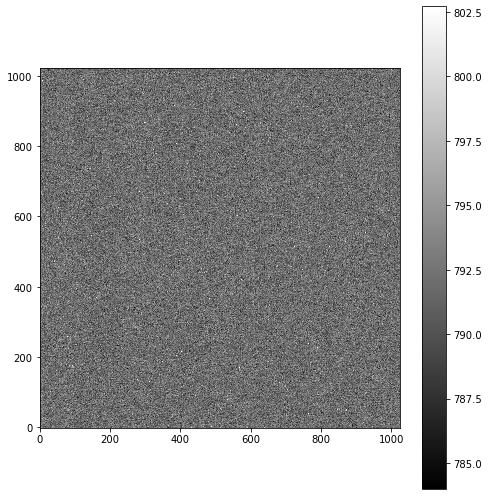

In [8]:
show_image(combined_bias)

0.04438509941101074 0.061775000000000004
-0.15 0.4210811945431873


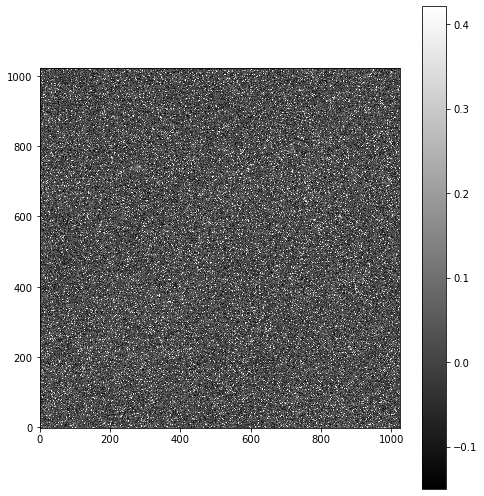

In [9]:
show_image(combined_darks)

1.0014521048171035 0.007349373620798667
0.9663860801187873 1.043501707646404


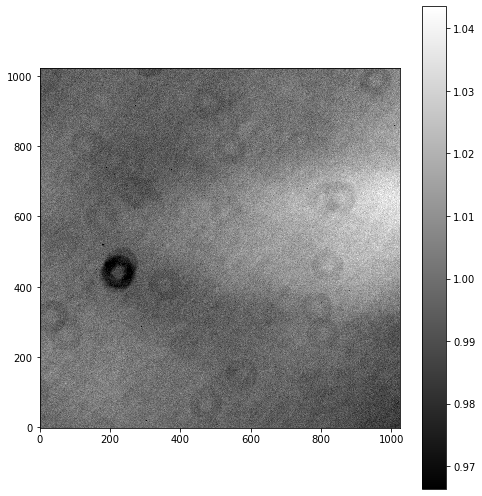

0.9998154631617386 0.0062203993055555675
0.9687138310185185 1.0169270833333333


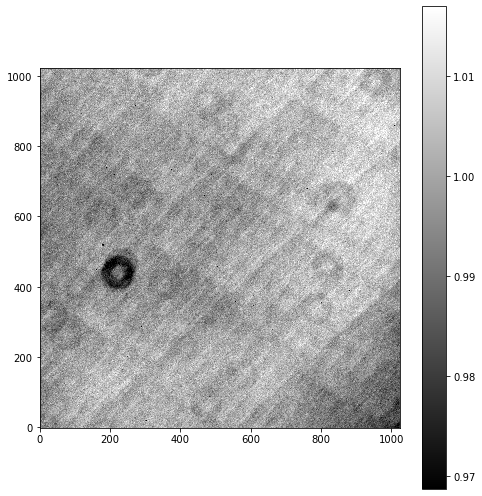

1.0001595859604786 0.00700594506011898
0.9688346883468836 1.0273118344566345


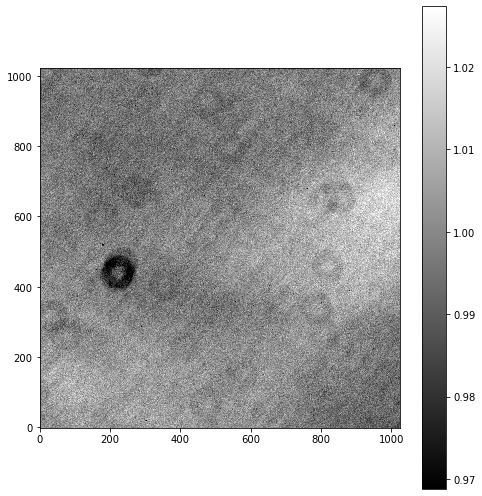

In [10]:
for filt,image in master_flats.items():
    show_image(image)

In [11]:
import ccdproc
images = files.files_filtered(imagetyp="Light Frame", include_path = True)

for image in images:
    var = ccdp.CCDData.read(image, unit = "adu")
    var_filt = var.header["filter"]
    
    corr_filt = master_flats[var_filt]
    
    var = ccdproc.ccd_process(var,
                             master_bias = combined_bias, dark_frame = combined_darks,
                             master_flat = corr_filt, exposure_key="exposure", exposure_unit = u.second,
                             dark_scale = True)
    proc_data = os.path.basename(image)
    var.write(data_red / ("BDF_"+proc_data), overwrite = True)

INFO:astropy:using the unit adu passed to the FITS reader instead of the unit adu in the FITS file.


INFO: using the unit adu passed to the FITS reader instead of the unit adu in the FITS file. [astropy.nddata.ccddata]
142.4449407376405 9.927011974689904
112.96284207716143 198.32058479443808


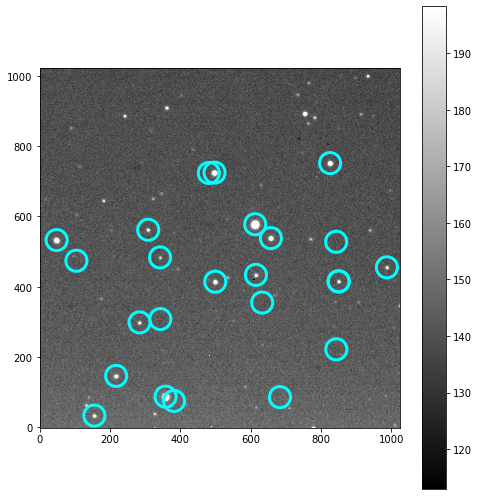

     xcentroid   ycentroid       mag
20  612.566262  578.001228 -4.489758
3   357.641977   87.484251 -3.570101
22  496.938570  724.823277 -2.456279
17   47.695635  532.944015 -2.273594
23  825.700621  751.822769 -2.088976
18  657.142694  538.544092 -1.984859
9   499.113584  414.420710 -1.594457
4   217.058481  146.451344 -1.122032
19  308.235612  562.222175 -0.684434
12  614.766589  433.783395 -0.662893
10  850.196974  415.307359 -0.596156
6   283.651964  298.616457 -0.477130
0   155.016276   33.530198 -0.449340
11  849.900413  415.523973 -0.376001
13  987.344184  455.327976 -0.343155
15  341.933334  483.560284 -0.147644
21  480.790874  723.846566 -0.128176
16  843.055611  527.975413 -0.098830
7   342.666936  308.259193 -0.097119
2   683.126015   85.993615 -0.046085
1   381.588761   75.313883 -0.026028
14  103.933840  474.137839 -0.024645
8   632.482335  355.063561 -0.018184
5   843.451551  222.088656 -0.014708
Point RA 23 41 54
Point Dec +44 10 47
objcoord <SkyCoord (ICRS): (ra, dec) 

In [ ]:
import plateSolve
pathlist = Path(data_red).glob('BDF_HH-And*.fit')

for path in pathlist:
    
    Rimage = ccdp.CCDData.read(path, unit="adu")
    
    check = plateSolve.autoSolve(path,Rimage, verbose = 1)
    if (check == True):
        #print(check)
        print(Rimage.header['JD-HELIO'])
        print("______________________________________________")
        
    else:
        print("!!!!!!!Plate solve did not work for", path)
        print("______________________________________________")
        print(" ")

['id', 'xcentroid', 'ycentroid', 'sharpness', 'roundness1', 'roundness2', 'npix', 'sky', 'peak', 'flux', 'mag']
Star magnitudes at reference aperture radius (4.25):
19 -8.694931879448104
1 -7.831123306228038
2 -7.756492555259083
22 -6.696816348879498
23 -6.215689487261629


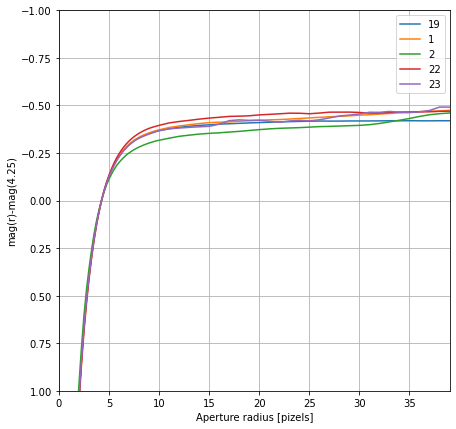

Optimum aperture:
19 7.5
1 6.25
2 5.75
22 5.5
23 5.0
17 5.0
27 4.75
11 4.5
4 4.75


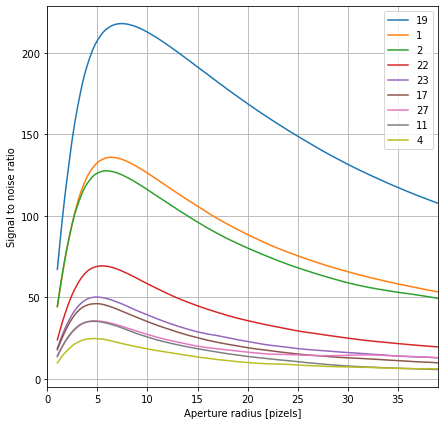

Mean optimum aperture radius = 4.625 from stars [4, 11]
Optimum aperture radius 4.5
stoppingidx 52 26.0
Systematic error from r>stopping aperture
Aperture correction: -0.4083105095905495 +/- 0.0029997817546642794
   0  -5.151 +/- 0.058 (stat) 0.003 (sys)
   1  -8.288 +/- 0.007 (stat) 0.003 (sys)
   2  -8.209 +/- 0.007 (stat) 0.003 (sys)
   3  -5.074 +/- 0.061 (stat) 0.003 (sys)
   4  -5.696 +/- 0.037 (stat) 0.003 (sys)
   5  -0.697 +/- 3.037 (stat) 0.003 (sys)
   6  -5.090 +/- 0.060 (stat) 0.003 (sys)
   7  -4.306 +/- 0.116 (stat) 0.003 (sys)
   8  -3.624 +/- 0.212 (stat) 0.003 (sys)
   9  -4.582 +/- 0.092 (stat) 0.003 (sys)
  10  -0.117 +/- 5.168 (stat) 0.003 (sys)
  11  -6.172 +/- 0.026 (stat) 0.003 (sys)
  12  -5.257 +/- 0.052 (stat) 0.003 (sys)
  13  -5.365 +/- 0.048 (stat) 0.003 (sys)
  14  -5.043 +/- 0.062 (stat) 0.003 (sys)
  15  -4.473 +/- 0.101 (stat) 0.003 (sys)
  16  -4.902 +/- 0.070 (stat) 0.003 (sys)
  17  -6.551 +/- 0.020 (stat) 0.003 (sys)
  18  -5.134 +/- 0.058 (stat) 0

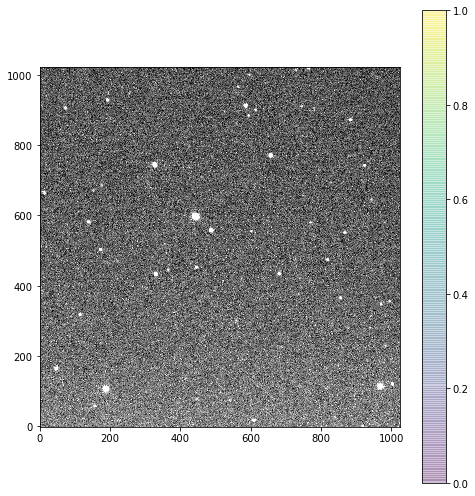

60.0
1.04350853630121


In [60]:
import warnings 

warnings.simplefilter("ignore")
os.chdir(Path(data_red))
#imR = CCDData.read("BDF_HHAnd_0000_002R.wcs.fit", unit = "adu")
imR = fits.open('BDF_HH-And-001B.wcs.fit')

#Find stars in the image
sources, bgplane= ap.findStars(imR)

#Generate a growth curve (i.e., measure fluxes at a range of aperture 
#sizes for all stars)
rap,mag,err,apers = ap.growthCurve(imR,sources)

#Plot the growth curve - use this to pick stars to use when calculating 
#the aperture correction
ap.plotGrowth(rap,mag,err,figsize=(7,7))
useForAppCorr = [22]
stoppingApertureRadius = 26.0

#Plot the SNR curve for a chosen star(s) and estimate the optimum aperture
ap.plotSNR(rap,mag,err,Nbrightest=9,figsize=(7,7))

#Apply an aperture correction for a chosen optimal aperture radius
imag,ierr,isys,apCorr = ap.apertureCorrection(rap,mag,err,optap=[4,11],
                                              stoppingAperture=stoppingApertureRadius,
                                              stars=useForAppCorr)


for i,m in enumerate(imag):
    print('%4d %7.3f +/- %5.3f (stat) %5.3f (sys)' % (sources['id'][i]-1,m,ierr[i],isys))

imag
ap.showimage(imR[0].data,stars=sources)
print(imR[0].header['EXPOSURE'])
print(imR[0].header["AIRMASS"])

In [65]:
xpix = sources["xcentroid"][11]
ypix = sources["ycentroid"][11]
w = WCS(imR[0].header)
#Rstarxy = np.transpose((sources['xcentroid'],sources['ycentroid']))
#radec = w.all_pix2world(Rstarxy,1)
print(xpix,ypix)
sky =w.pixel_to_world(xpix,ypix)
print(sky)

971.1005575059631 350.6010127201141
<SkyCoord (ICRS): (ra, dec) in deg
    (355.6344353, 44.16758454)>


['id', 'xcentroid', 'ycentroid', 'sharpness', 'roundness1', 'roundness2', 'npix', 'sky', 'peak', 'flux', 'mag']
Star magnitudes at reference aperture radius (3.5):
26 -9.391262888928347
4 -9.21955493538276
5 -8.623546797700927
15 -7.58283936286133
33 -7.45330897921596


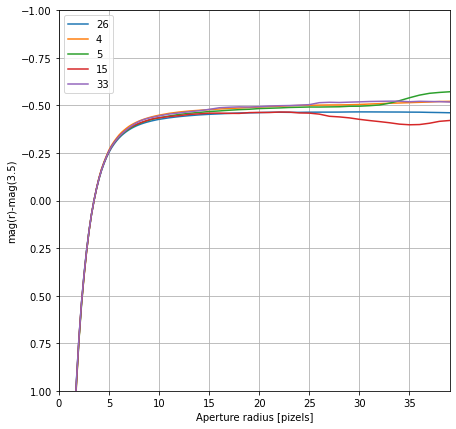

Optimum aperture:
26 6.75
4 6.75
5 5.75
15 5.0
33 5.0
34 4.5
23 4.25
42 4.25
7 4.25


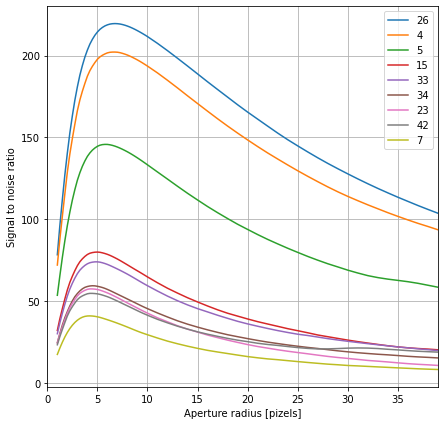

Mean optimum aperture radius = 4.25 from stars [23, 42]
Optimum aperture radius 4.25
stoppingidx 52 26.0
Systematic error from r>stopping aperture
Aperture correction: -0.30675637301245295 +/- 0.0012680830294048184
   0  -5.239 +/- 0.090 (stat) 0.001 (sys)
   1  -6.166 +/- 0.042 (stat) 0.001 (sys)
   2  -5.428 +/- 0.077 (stat) 0.001 (sys)
   3  -4.952 +/- 0.115 (stat) 0.001 (sys)
   4  -9.692 +/- 0.005 (stat) 0.001 (sys)
   5  -9.091 +/- 0.007 (stat) 0.001 (sys)
   6  -6.227 +/- 0.040 (stat) 0.001 (sys)
   7  -7.024 +/- 0.022 (stat) 0.001 (sys)
   8  -4.921 +/- 0.118 (stat) 0.001 (sys)
   9  -4.178 +/- 0.226 (stat) 0.001 (sys)
  10  -6.012 +/- 0.048 (stat) 0.001 (sys)
  11  -5.175 +/- 0.094 (stat) 0.001 (sys)
  12  -5.445 +/- 0.075 (stat) 0.001 (sys)
  13  -4.607 +/- 0.154 (stat) 0.001 (sys)
  14  -4.103 +/- 0.241 (stat) 0.001 (sys)
  15  -8.052 +/- 0.012 (stat) 0.001 (sys)
  16  -6.556 +/- 0.031 (stat) 0.001 (sys)
  17  -4.934 +/- 0.116 (stat) 0.001 (sys)
  18  -6.322 +/- 0.037 (stat)

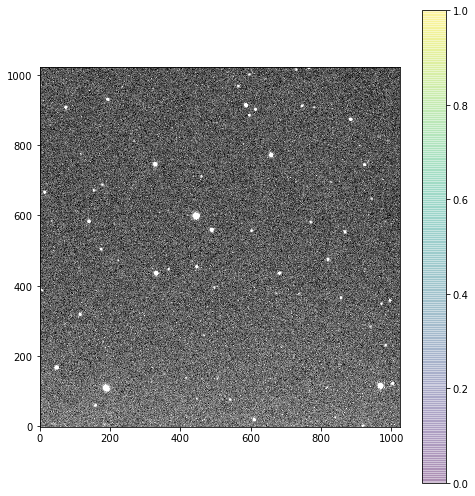

30.0
1.04312301993996


In [63]:
os.chdir(Path(data_red))
#imR = CCDData.read("BDF_HHAnd_0000_002R.wcs.fit", unit = "adu")
imR = fits.open('BDF_HH-And-001V.wcs.fit')

#Find stars in the image
sources, bgplane= ap.findStars(imR)

#Generate a growth curve (i.e., measure fluxes at a range of aperture 
#sizes for all stars)
rap,mag,err,apers = ap.growthCurve(imR,sources)

#Plot the growth curve - use this to pick stars to use when calculating 
#the aperture correction
ap.plotGrowth(rap,mag,err,figsize=(7,7))
useForAppCorr = [26]
stoppingApertureRadius = 26.0

#Plot the SNR curve for a chosen star(s) and estimate the optimum aperture
ap.plotSNR(rap,mag,err,Nbrightest=9,figsize=(7,7))

#Apply an aperture correction for a chosen optimal aperture radius
imag,ierr,isys,apCorr = ap.apertureCorrection(rap,mag,err,optap=[23,42],
                                              stoppingAperture=stoppingApertureRadius,
                                              stars=useForAppCorr)

for i,m in enumerate(imag):
    print('%4d %7.3f +/- %5.3f (stat) %5.3f (sys)' % (sources['id'][i]-1,m,ierr[i],isys))

imag
ap.showimage(imR[0].data,stars=sources)
print(imR[0].header['EXPOSURE'])
print(imR[0].header["AIRMASS"])

In [64]:
xpix = sources["xcentroid"][15]
ypix = sources["ycentroid"][15]
w = WCS(imR[0].header)
#Rstarxy = np.transpose((sources['xcentroid'],sources['ycentroid']))
#radec = w.all_pix2world(Rstarxy,1)
sky =w.pixel_to_world(xpix,ypix)
print(sky)

<SkyCoord (ICRS): (ra, dec) in deg
    (355.48027459, 44.16788039)>
